<a href="https://colab.research.google.com/github/SrikanthIITB/AI_School_Tracker/blob/main/docs/examples/building_regularization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Building Regularization

[![image](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/opengeos/geoai/blob/main/docs/examples/building_regularization.ipynb)

## Install package
To use the `geoai-py` package, ensure it is installed in your environment. Uncomment the command below if needed.

In [7]:
%pip install geoai-py

## Import package

In [8]:
import geoai

## Download sample data

In [9]:
naip_url = (
    "https://huggingface.co/datasets/giswqs/geospatial/resolve/main/naip_train.tif"
)
masks_url = "https://huggingface.co/datasets/giswqs/geospatial/resolve/main/naip_building_masks.tif"

In [10]:
masks_path = geoai.download_file(masks_url)
naip_path = geoai.download_file(naip_url)

File already exists: naip_building_masks.tif
File already exists: naip_train.tif


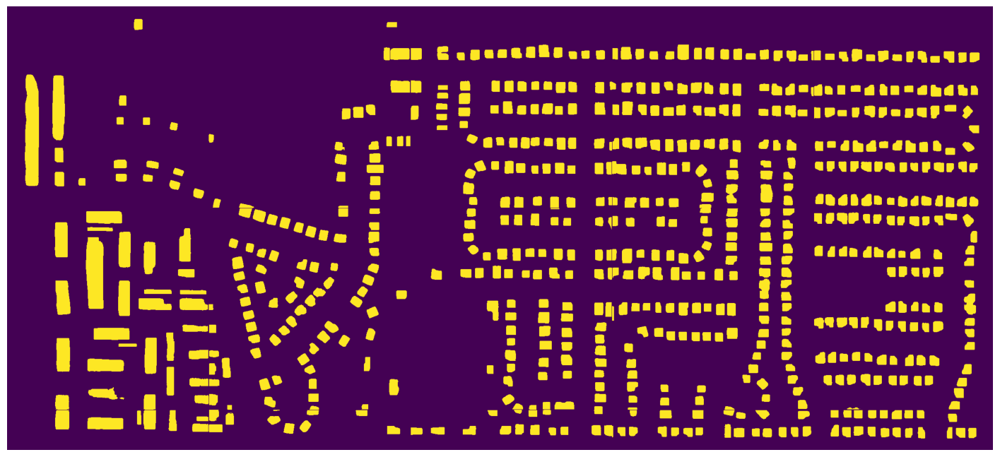

In [11]:
geoai.view_image(masks_path, figsize=(18, 10))

In [14]:
geoai.create_split_map(
    left_layer=masks_url,
    right_layer=naip_url,
    left_label="Building Masks",
    right_label="NAIP Imagery",
    left_args={
        "colormap": {"255": "#0000ff"},
        "opacity": 0.5,
    },
    basemap=naip_url,
)

Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

In [13]:
from google.colab import output
output.enable_custom_widget_manager()

Support for third party widgets will remain active for the duration of the session. To disable support:

In [ ]:
from google.colab import output
output.disable_custom_widget_manager()

## Convert raster to vector

In [29]:
 from google.colab import files
 gdf2 = geoai.raster_to_vector(masks_path, output_path="naip_building_masks.geojson")
gdf=files.upload()

Vectorized data saved to naip_building_masks.geojson


Saving naip_building_masks.geojson to naip_building_masks (1).geojson


In [35]:
import geopandas as gpd

data = gpd.read_file(
    "/content/testvectors.geojson"
)
gdf=data
print(type(data))

<class 'geopandas.geodataframe.GeoDataFrame'>


In [36]:
geoai.view_vector_interactive(
    gdf, style_kwds={"color": "blue", "fillOpacity": 0.4}, tiles=naip_url
)

In [17]:
geoai.create_split_map(
    left_layer=gdf,
    right_layer=naip_url,
    left_label="Buildings",
    right_label="NAIP Imagery",
    left_args={"style": {"color": "blue"}, "fillOpacity": 0.4},
    basemap=naip_url,
)

Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

## Building regularization

In [77]:
gdf_regularized = geoai.regularization(
    building_polygons=gdf,
    angle_tolerance=10,
    simplify_tolerance=0.5,
    orthogonalize=True,
    preserve_topology=False,
)

Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Not enough coordinates for angle calculation: 0
Simplified geometry has no exterior: MULTIPOLYGON (((683310.7693419532 2789426.9399312455, 683306.2405 2789427.0122, 683306.0655 2789429.3572, 683306.5905 2789427.1872, 683310.76934195

In [78]:
gdf_regularized

,geometry
0,"POLYGON ((683308.69 2789374.372, 683308.76 278..."
1,"POLYGON ((683304.584 2789380.974, 683305.984 2..."
2,"POLYGON ((683305.33 2789381.127, 683305.33 278..."
3,"POLYGON ((683305.226 2789381.827, 683305.226 2..."
4,"POLYGON ((683307.36 2789382.842, 683307.36 278..."
...,...
4808,"POLYGON ((683336.2 2789502.542, 683336.2 27895..."
4809,"POLYGON ((683323.986 2789502.752, 683323.95 27..."
4810,"POLYGON ((683336.2 2789503.102, 683336.2 27895..."
4811,"POLYGON ((683318.7 2789503.102, 683318.7 27895..."


In [79]:
geoai.view_vector_interactive(
    gdf_regularized, style_kwds={"color": "red", "fillOpacity": 0.4}, tiles=naip_url
)

In [44]:
geoai.create_split_map(
    left_layer=gdf_regularized,
    right_layer=naip_url,
    left_label="Regularized Buildings",
    right_label="NAIP Imagery",
    left_args={"style": {"color": "red"}, "fillOpacity": 0.4},
    basemap=naip_url,
)

Map(center=[20, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_text…

## Hybrid regularization

In [45]:
gdf_hybrid = geoai.hybrid_regularization(gdf)

In [46]:
geoai.view_vector_interactive(
    gdf_hybrid, style_kwds={"color": "green", "fillOpacity": 0.4}, tiles=naip_url
)

In [ ]:
geoai.create_split_map(
    left_layer=gdf_regularized,
    right_layer=naip_url,
    left_label="Regularized Buildings",
    right_label="NAIP Imagery",
    left_args={"style": {"color": "green", "fillOpacity": 0.4}},
    basemap=naip_url,
)

## Adaptive regularization

In [47]:
gdf_adaptive = geoai.adaptive_regularization(
    building_polygons=gdf,
    simplify_tolerance=0.5,
    area_threshold=0.9,
    preserve_shape=True,
)

In [48]:
geoai.view_vector_interactive(
    gdf_adaptive, style_kwds={"color": "yellow", "fillOpacity": 0.4}, tiles=naip_url
)

In [ ]:
geoai.create_split_map(
    left_layer=gdf_adaptive,
    right_layer=naip_url,
    left_label="Adaptive Regularization Buildings",
    right_label="NAIP Imagery",
    left_args={"style": {"color": "yellow", "fillOpacity": 0.4}},
    basemap=naip_url,
)

## Compare regularization methods

In [49]:
import leafmap.foliumap as leafmap

In [64]:
m = leafmap.Map()
m.add_basemap("SATELLITE")
m.add_gdf(gdf, layer_name="Original")
#m.add_gdf(gdf_regularized, style={"color": "red", "fillOpacity": 0}, layer_name="Regularized")
#m.add_gdf(gdf_hybrid, style={"color": "green", "fillOpacity": 0}, layer_name="Hybrid")
m.add_gdf(gdf_adaptive, style={"color": "yellow", "fillOpacity": 0}, layer_name="Adaptive")
legend = {
    "Original": "blue",
    "Regularized": "red",
    "Hybrid": "green",
    "Adaptive": "yellow",
}
m.add_legend(title="Building Footprints", legend_dict=legend)
m